# Lab12-2 Visualization & Style Transfer

In [1]:
import functools
import time
import os
import random
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import IPython.display as display
from pathlib import Path
from PIL import Image
from matplotlib import pyplot
from guided_backprop import GuidedBackprop
from tqdm.notebook import tqdm

tf.config.experimental_run_functions_eagerly(True)
tf.config.run_functions_eagerly(True)
mpl.rcParams['figure.figsize'] = (12,12)
mpl.rcParams['axes.grid'] = False

2021-11-18 19:39:27.886894: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


Instructions for updating:
Use `tf.config.run_functions_eagerly` instead of the experimental version.


In [2]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Restrict TensorFlow to only use the fourth GPU
        tf.config.experimental.set_visible_devices(gpus[0], 'GPU')

        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

1 Physical GPUs, 1 Logical GPUs


2021-11-18 19:39:28.993111: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-11-18 19:39:29.048433: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-18 19:39:29.048936: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: NVIDIA GeForce RTX 3060 computeCapability: 8.6
coreClock: 1.852GHz coreCount: 28 deviceMemorySize: 11.77GiB deviceMemoryBandwidth: 335.32GiB/s
2021-11-18 19:39:29.048952: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-11-18 19:39:29.053797: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11
2021-11-18 19:39:29.053832: I tensorflow/stream_executor/pl

In [3]:
if not os.path.exists("input") : os.mkdir("input")
if not os.path.exists("output_HW") : os.mkdir("output_HW")
if not os.path.exists("model") : os.mkdir("model")

# Part I (A Neural Algorithm of Artistic Style)

1. Implement total variational loss. tf.image.total_variation is not allowed (10%).

2. Change the weights for the style, content, and total variational loss (10%).

3. Use other layers in the model (10%). You need to calculate both content loss and style loss from different layers in the model

4. Write a brief report. Explain how the results are affected when you change the weights, use different layers for calculating loss (10%). Insert markdown cells in the notebook to write the report.

## 一. 前置作業
我們先引進兩張圖片以及pretrain好的VGG。

In [4]:
def load_img(path_to_img):
    max_dim = 512
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim

    new_shape = tf.cast(shape * scale, tf.int32)

    img = tf.image.resize(img, new_shape)
    # in order to use CNN, add one additional dimension 
    # to the original image
    # img shape: [height, width, channel] -> [batch_size, height, width, channel]
    img = img[tf.newaxis, :]
    
    return img

In [5]:
def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)

    plt.imshow(image)
    if title:
        plt.title(title)

利用路徑呼叫圖片。

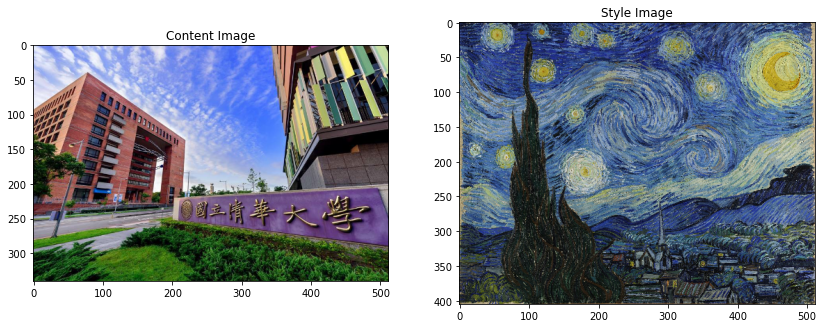

In [6]:
content_path = './input/content_nthu.jpg'
style_path = './input/style_starry_night.jpg'

content_image = load_img(content_path)
style_image = load_img(style_path)

plt.figure(figsize=(14,10))
plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

接著呼叫由imagenet pretrain好的VGG19

In [7]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
vgg.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0     

## 二. Extract style and content
### 1. 定義一個style/content的抽取器
首先我們要定義我們希望從VGG的哪一層抽出content以及style。Content features就是直接將Content image餵進去神經網路後，在我們想指定的某一層抽出來。Style feature則是先指定神經網路中的某幾層（以我們VGG的例子是各個block的第一層），計算其在這幾層中feature的layer（channel）-wise correlation (又稱為gram matrix)。

In [8]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2'] 

# Style layer of interest
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

接著就可以開始準備model了。我們的model就是把VGG中名字與指定為content/style layer的那幾層抽出來，return成新的model。這個model是用來extract style還是content取決於他的參數給的是content_layers還是style_layers。

In [9]:
def vgg_layers(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. Load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

另外還要定義gram matrix。

In [10]:
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)

我們把以上的東西組合成抽取器。這個抽取器由兩個神經網路組成：抽取style的神經網路以及抽取content的神經網路。

In [11]:
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__() #Python的繼承？
        self.vgg =  vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers], 
                                          outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        content_dict = {content_name:value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name:value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}

        return {'content':content_dict, 'style':style_dict}

爾後若要更改style_layers, content_layers時，先直接重新定義那兩個變數，以使用VGG的不同layer，再使用

extractor = StyleContentModel(style_layers, content_layers)

呼叫即可。我們讓抽取器吃一張圖片看看能不能正常運作。

In [12]:
extractor = StyleContentModel(style_layers, content_layers)
results = extractor(tf.constant(content_image))
style_results = results['style']

print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())

2021-11-18 19:39:30.139699: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudnn.so.8
2021-11-18 19:39:30.551362: I tensorflow/stream_executor/cuda/cuda_dnn.cc:359] Loaded cuDNN version 8100
2021-11-18 19:39:31.023338: E tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2021-11-18 19:39:31.023363: W tensorflow/stream_executor/gpu/asm_compiler.cc:56] Couldn't invoke ptxas --version
2021-11-18 19:39:31.023732: E tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2021-11-18 19:39:31.023770: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] Internal: Failed to launch ptxas
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.
2021-11-18 19:39:31.101060: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully ope

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.105066136
    max:  19345.074
    mean:  937.94836

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  178929.03
    mean:  28007.361

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.049528908
    max:  1207017.5
    mean:  32819.58

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  9239592.0
    mean:  420596.84

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  180988.98
    mean:  3430.0112

Contents:
   block5_conv2
    shape:  (1, 21, 32, 512)
    min:  0.0
    max:  1435.1227
    mean:  21.45638


2021-11-18 19:39:32.050839: I tensorflow/stream_executor/cuda/cuda_blas.cc:1838] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


In [13]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

## 三. 定義各種loss與train function
### 1. 定義三種loss
這裡我們要使用三種loss，第一種是content loss，第二種是style loss，第三種是total variation loss
$$V(y)=\sum_i\sum_j|y_{i+1,j}-y{i,j}|+|y_{i,j+1}-y_{i,j}|$$
實際訓練時我們使用的是三者加起來
$$\mathscr{L}=\alpha\mathscr{L}_\text{content}+\beta\mathscr{L}_\text{style}+\gamma\mathscr{L}_\text{total variation}$$
style_content_loss已經幫我們寫好了。

In [14]:
def style_content_loss(outputs, style_weight, content_weight):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

然而我在實做total_variation_loss時遇到了不少的麻煩。一開始我是直接傳一個tensor進去這個函數，接著轉為ndarray之後，利用三個for迴圈（分別是height, weight以及channel)，以及np.abs()函式按照公式計算各個頻道的total variation loss。然而這時會報出「不支援把tensorflow的物件直接傳入numpy」等等的錯誤，接著我嘗試直接讀取image這個tensor的value，發現還是沒有辦法正常使用numpy的函式。試來試去都沒有辦法順利解決。索性經過同組組員的提點，建議我可以用tensorflow內建的reduce_sum以及tf.abs函式直接進行運算。之後就順利解決這個bug了。

reduce_sum函式有點類似map reduce中的reduce function，可以沿著某個axis將tensor的值加起來，維度也因此減1，如此一來就不需要使用大量for迴圈了，十分方便。

In [15]:
def total_variation_loss(image):
    [batch, height, width, channel] = image.get_shape().as_list()
    loss1 = tf.reduce_sum(tf.abs(image[:, 1:, :, :] - image[:, :height-1, :, :]))
    loss2 = tf.reduce_sum(tf.abs(image[:, :, 1:, :] - image[:, :, :width-1, :]))
    return tf.add(loss1, loss2)

### 2. train function
為了方便training，我直接寫一個train function可以接受不同的optimizer，各種loss之weight。另外，為了不讓梯度爆炸，先強制讓梯度的大小困在0與1之間。

In [16]:
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [17]:
@tf.function()
def my_train_step(image, opt, style_weight, content_weight, total_variation_weight):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs, style_weight, content_weight)
        loss += total_variation_weight*total_variation_loss(image)

    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

In [18]:
def train_style_transfer(image, 
                         opt=tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1),
                         epochs=10, #要多少epoch? 一個epoch show 1張圖
                         steps_per_epoch=100, #每個epoch要train多少step
                         style_weight=0.1, 
                         content_weight=0.1, 
                         total_variation_weight=0):
    start = time.time()

    epochs = epochs
    steps_per_epoch = steps_per_epoch

    step = 0
    for n in tqdm(range(epochs)):
        for m in tqdm(range(steps_per_epoch)):
            step += 1
            my_train_step(image, opt, style_weight, content_weight, total_variation_weight)
        imshow(image.read_value())
        plt.title("Train step: {}".format(step))
        plt.show()

    end = time.time()
    print("Total time: {:.1f}".format(end-start))
    return image

## 四. 改變不同weight的研究
首先引入圖片以及定義好我們要用的optimizer。

In [19]:
image = tf.Variable(content_image)
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

我們試試看三個case
### 1. 三種loss的權重都是1

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

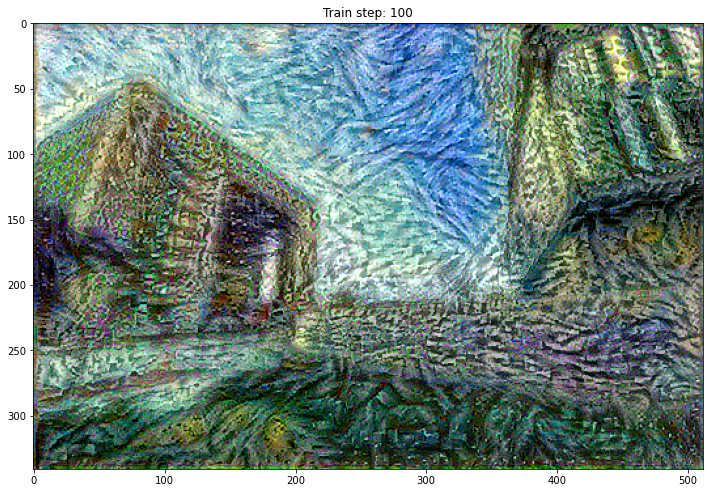

  0%|          | 0/100 [00:00<?, ?it/s]

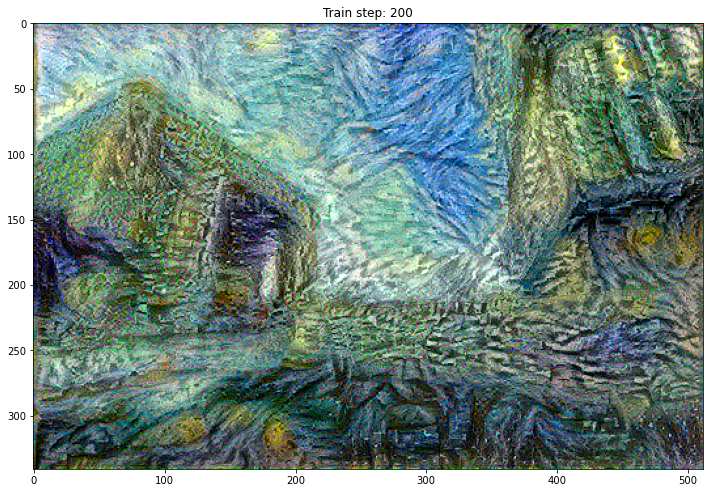

  0%|          | 0/100 [00:00<?, ?it/s]

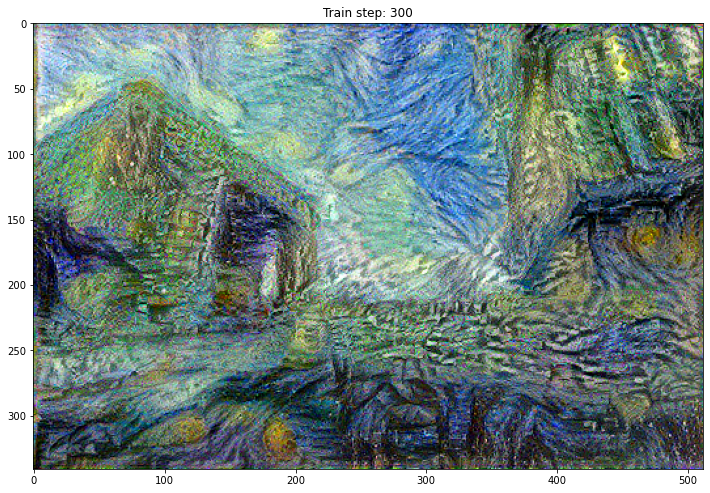

  0%|          | 0/100 [00:00<?, ?it/s]

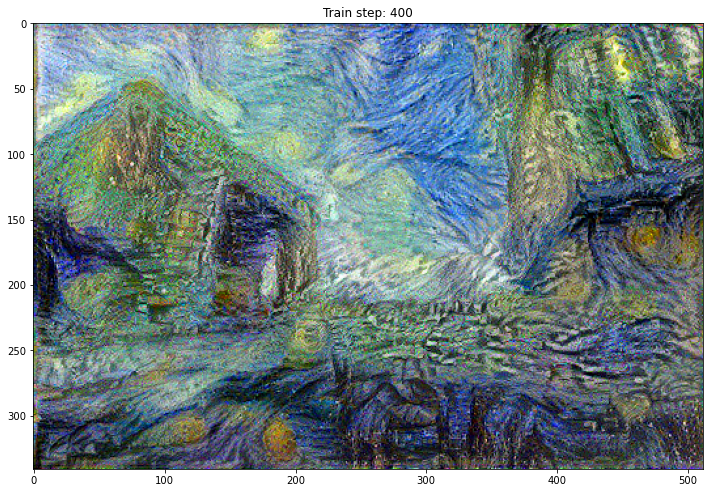

  0%|          | 0/100 [00:00<?, ?it/s]

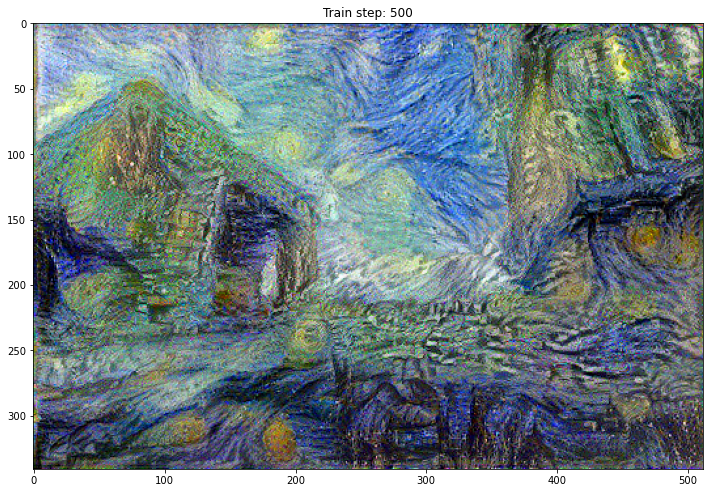

  0%|          | 0/100 [00:00<?, ?it/s]

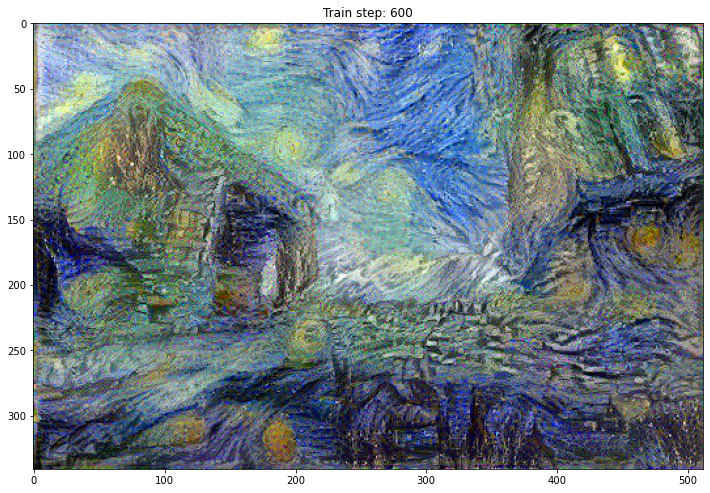

  0%|          | 0/100 [00:00<?, ?it/s]

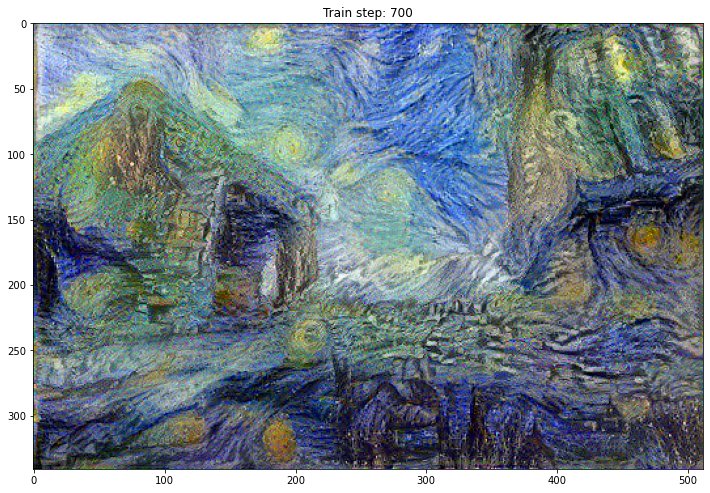

  0%|          | 0/100 [00:00<?, ?it/s]

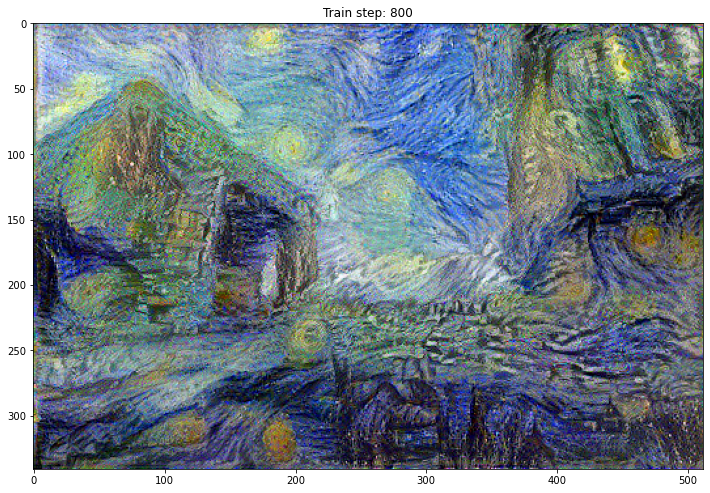

  0%|          | 0/100 [00:00<?, ?it/s]

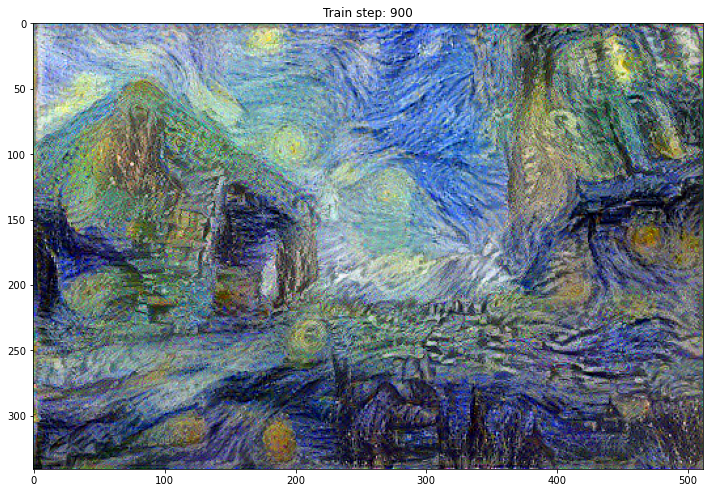

  0%|          | 0/100 [00:00<?, ?it/s]

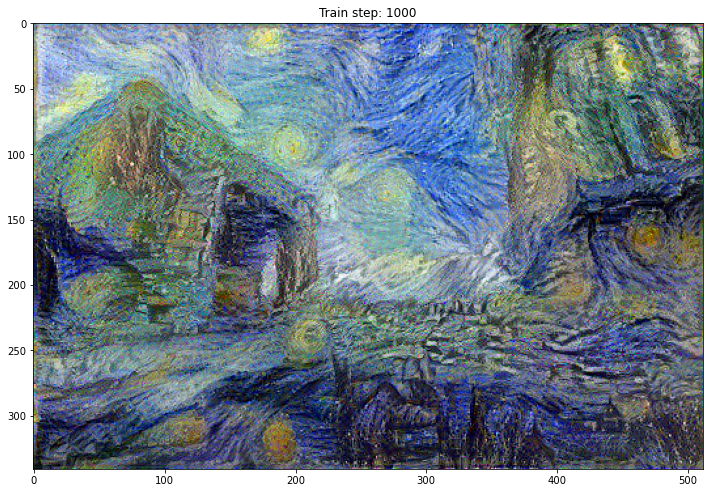

Total time: 70.4


In [20]:
image1= train_style_transfer(image, 
                             opt=opt,
                             epochs=10, 
                             steps_per_epoch=100,
                             style_weight=1, 
                             content_weight=1, 
                             total_variation_weight=1)

### 2. 偏重total variation

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

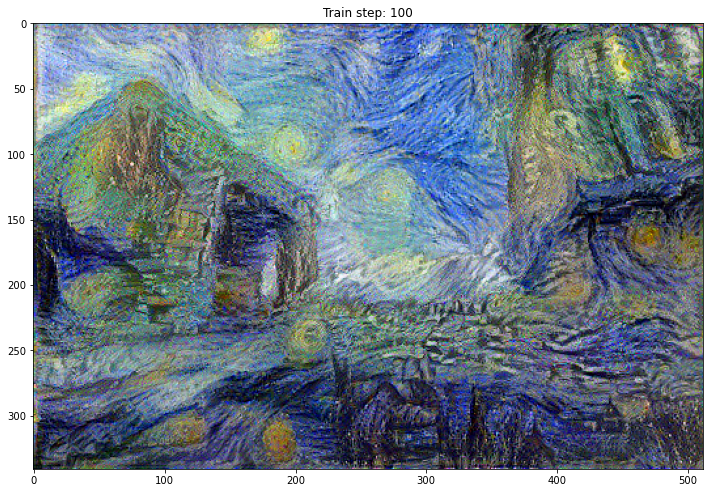

  0%|          | 0/100 [00:00<?, ?it/s]

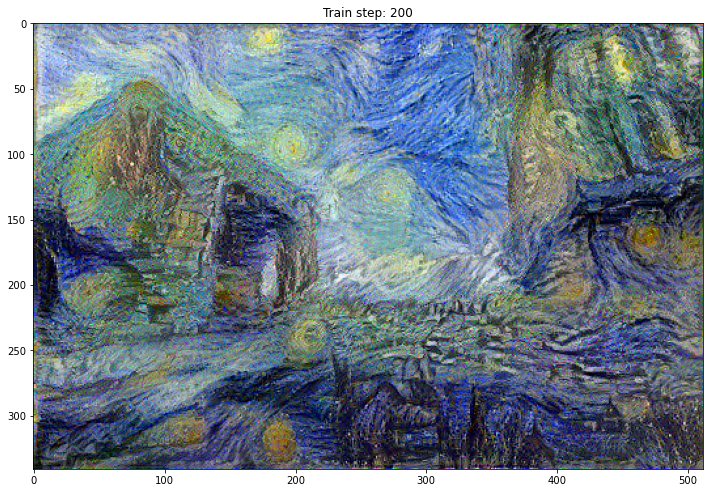

  0%|          | 0/100 [00:00<?, ?it/s]

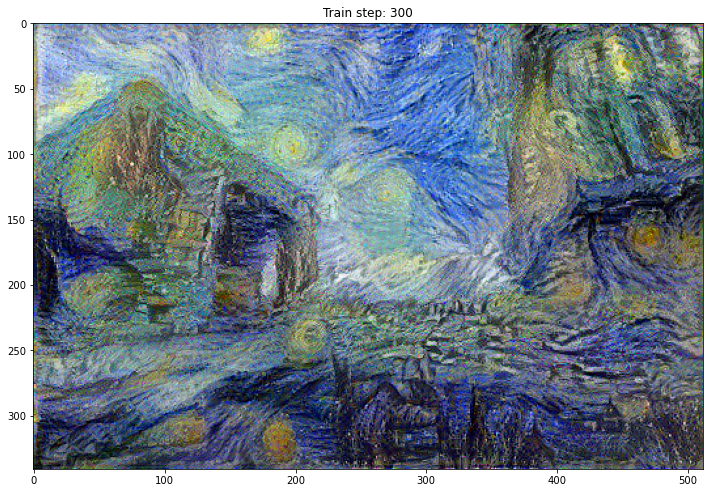

  0%|          | 0/100 [00:00<?, ?it/s]

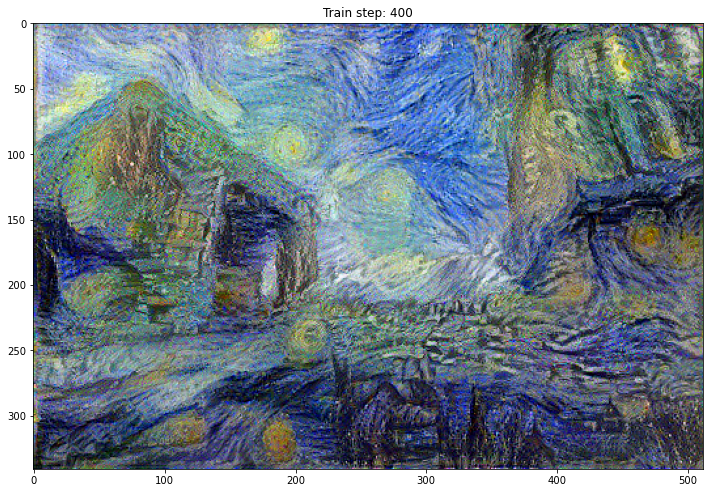

  0%|          | 0/100 [00:00<?, ?it/s]

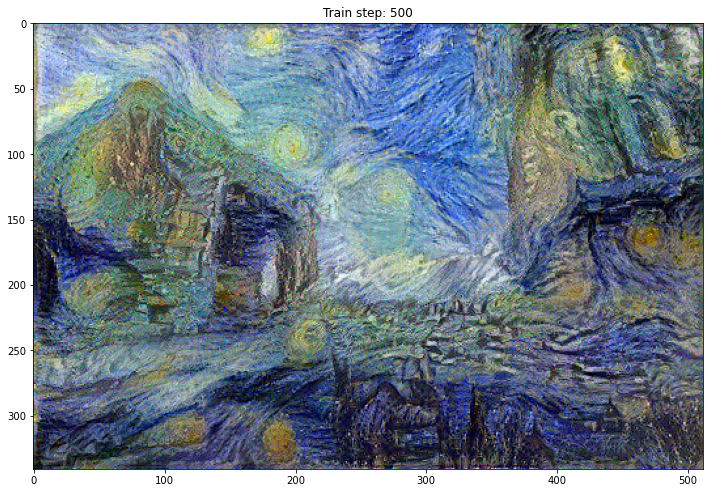

  0%|          | 0/100 [00:00<?, ?it/s]

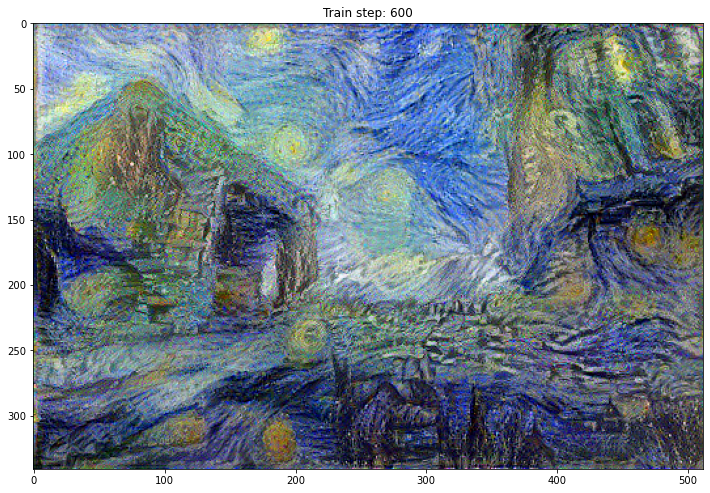

  0%|          | 0/100 [00:00<?, ?it/s]

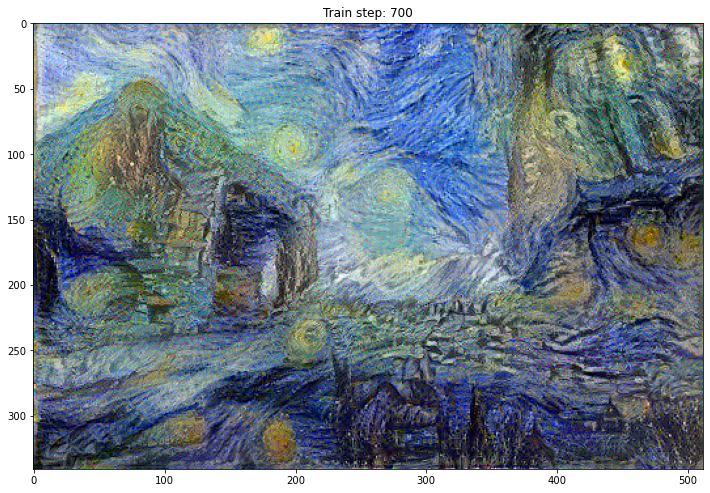

  0%|          | 0/100 [00:00<?, ?it/s]

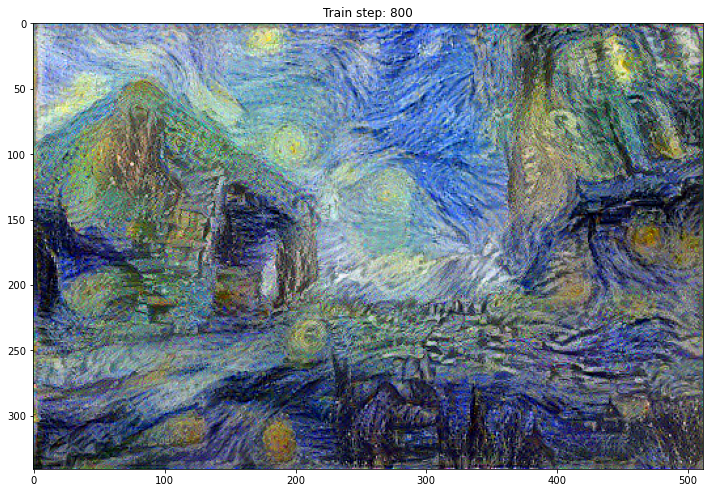

  0%|          | 0/100 [00:00<?, ?it/s]

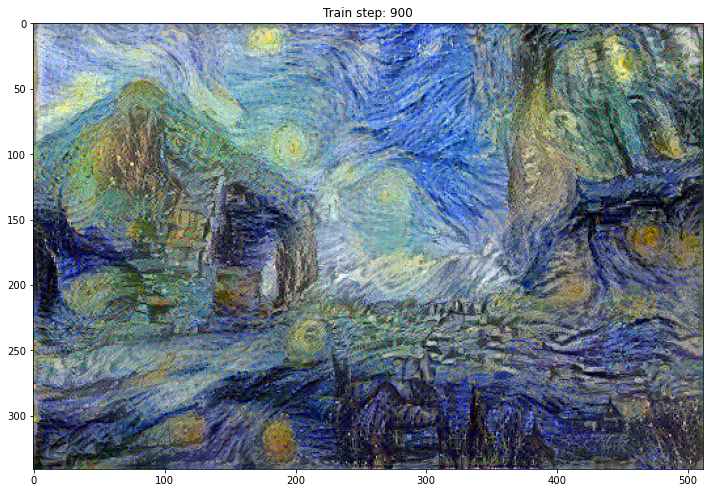

  0%|          | 0/100 [00:00<?, ?it/s]

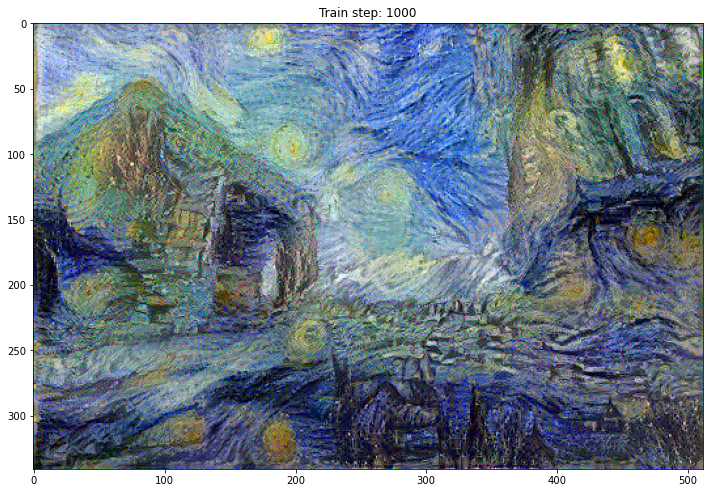

Total time: 69.3


In [21]:
image2= train_style_transfer(image, 
                             opt=opt,
                             epochs=10, 
                             steps_per_epoch=100,
                             style_weight=0.1, 
                             content_weight=0.1, 
                             total_variation_weight=1.5)

### 3. 不使用total variation，側重style loss

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

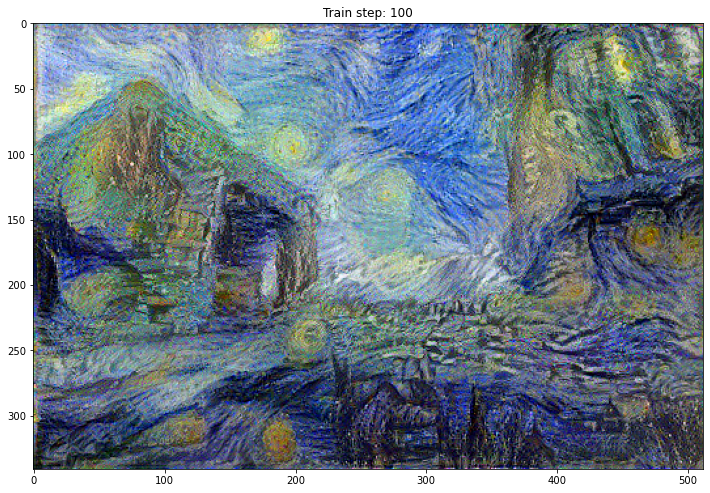

  0%|          | 0/100 [00:00<?, ?it/s]

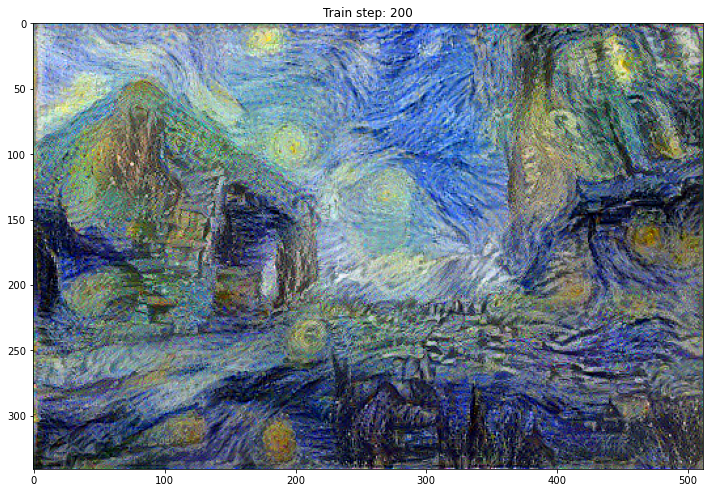

  0%|          | 0/100 [00:00<?, ?it/s]

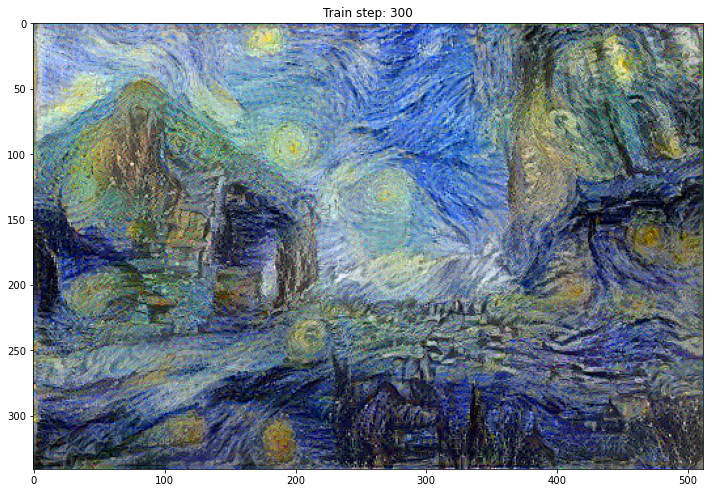

  0%|          | 0/100 [00:00<?, ?it/s]

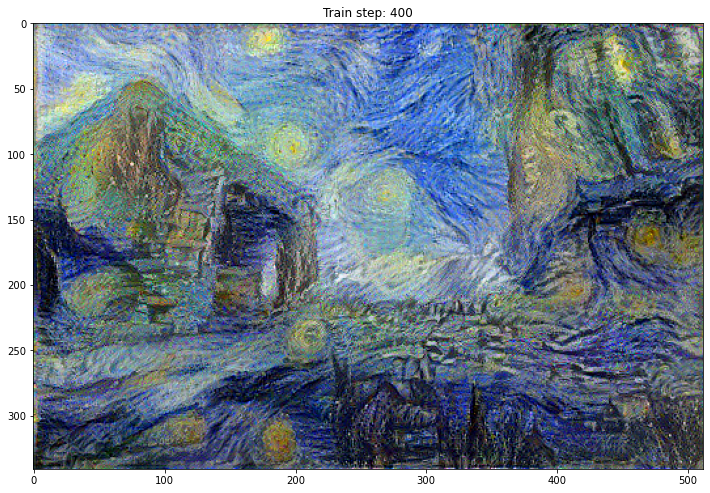

  0%|          | 0/100 [00:00<?, ?it/s]

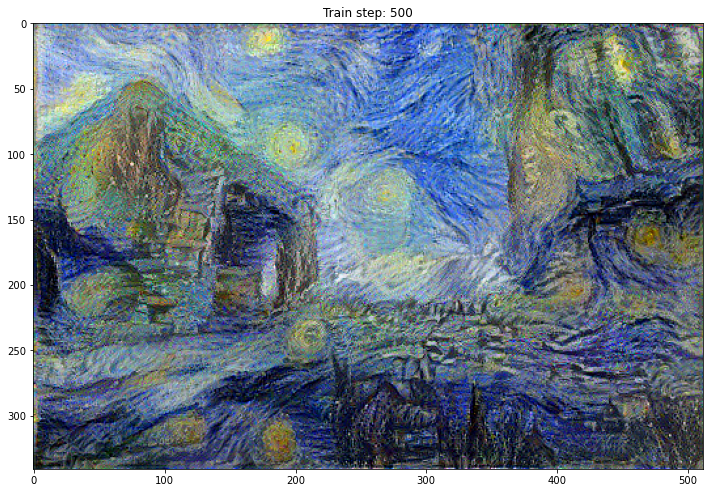

  0%|          | 0/100 [00:00<?, ?it/s]

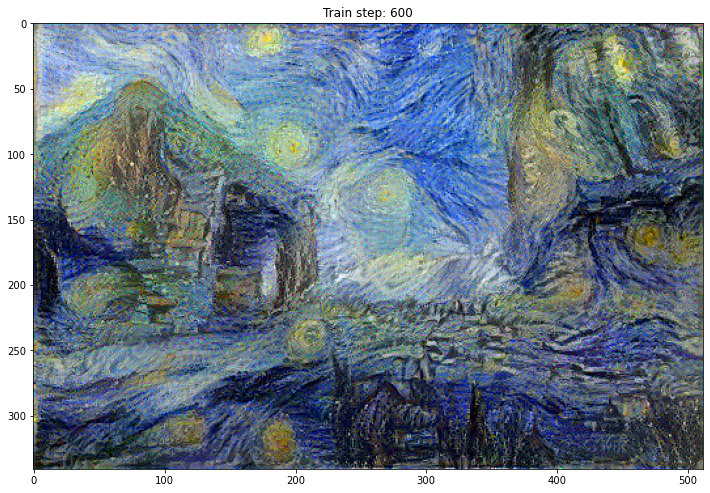

  0%|          | 0/100 [00:00<?, ?it/s]

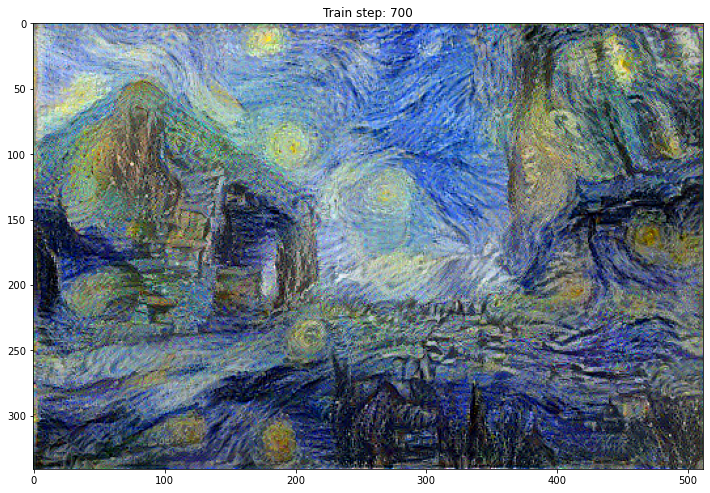

  0%|          | 0/100 [00:00<?, ?it/s]

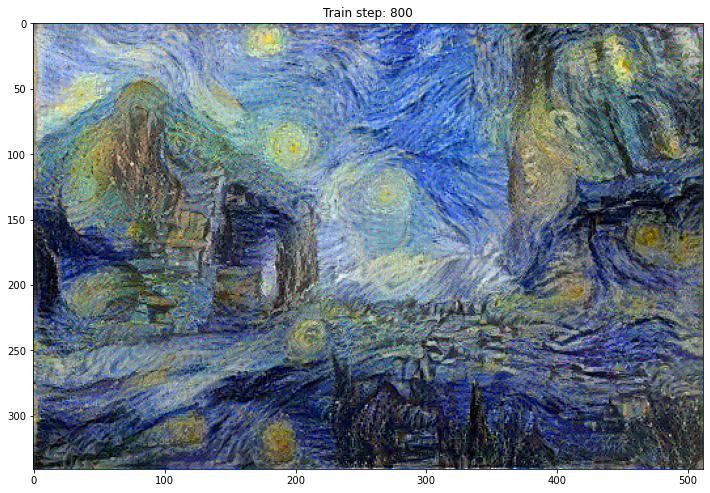

  0%|          | 0/100 [00:00<?, ?it/s]

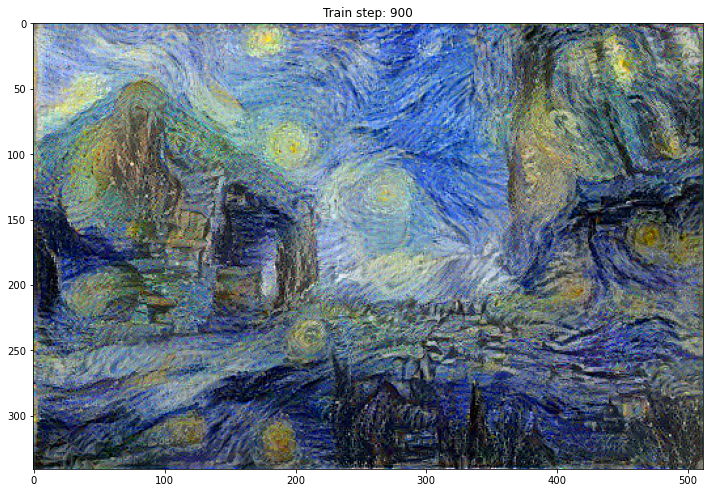

  0%|          | 0/100 [00:00<?, ?it/s]

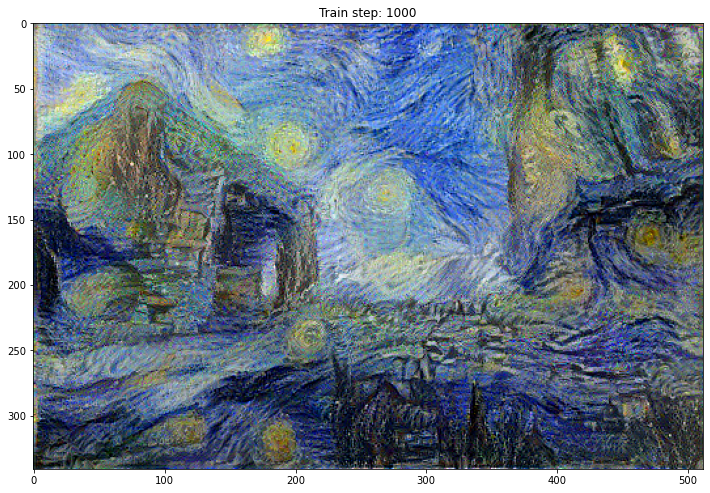

Total time: 69.8


In [22]:
image3= train_style_transfer(image, 
                             opt=opt,
                             epochs=10, 
                             steps_per_epoch=100,
                             style_weight=2, 
                             content_weight=0.1, 
                             total_variation_weight=0)

In [23]:
file_name = './output_HW/style_transfer_nthu_starry_night_equal_weight.png'
mpl.image.imsave(file_name, image1[0].numpy())
file_name = './output_HW/style_transfer_nthu_starry_night_total.png'
mpl.image.imsave(file_name, image2[0].numpy())
file_name = './output_HW/style_transfer_nthu_starry_night_style.png'
mpl.image.imsave(file_name, image3[0].numpy())

## 五. 不同layer與loss的研究 
這一次我把style layer換成每一個block的conv4，content layer換成block5_conv2，用藝術的角度評估兩個造成的不同。

In [24]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2'] 

# Style layer of interest
style_layers = ['block1_conv2',
                'block2_conv2',
                'block3_conv4', 
                'block4_conv4', 
                'block5_conv4']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

In [25]:
extractor = StyleContentModel(style_layers, content_layers)
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']


print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.105066136
    max:  19345.074
    mean:  937.94836

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  178929.03
    mean:  28007.361

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.049528908
    max:  1207017.5
    mean:  32819.58

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  9239592.0
    mean:  420596.84

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  180988.98
    mean:  3430.0112

Contents:
   block5_conv2
    shape:  (1, 21, 32, 512)
    min:  0.0
    max:  1435.1227
    mean:  21.45638


為了客觀比較，我使用一模一樣的optimizer以及三種loss的weight都是1，方便與四-1的結果做比較。

In [26]:
image = tf.Variable(content_image)
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

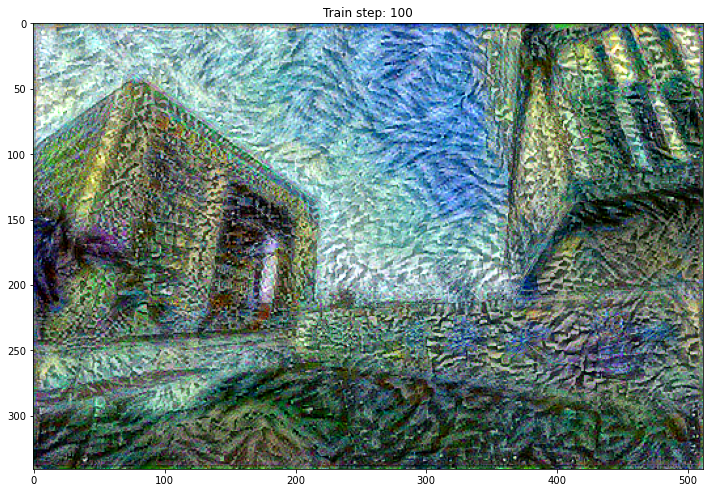

  0%|          | 0/100 [00:00<?, ?it/s]

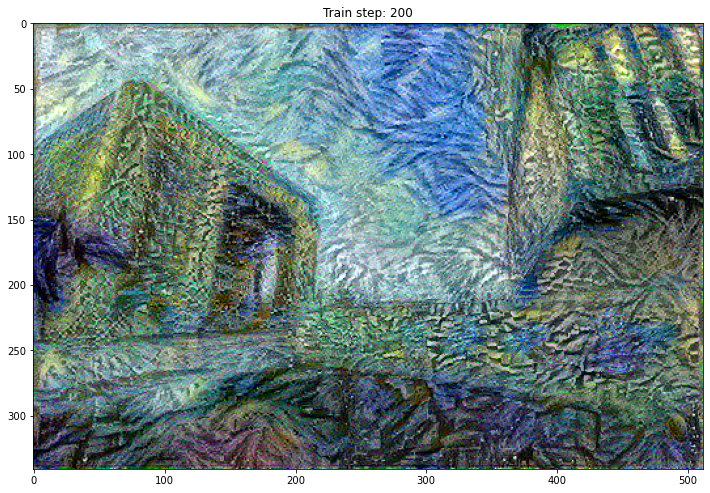

  0%|          | 0/100 [00:00<?, ?it/s]

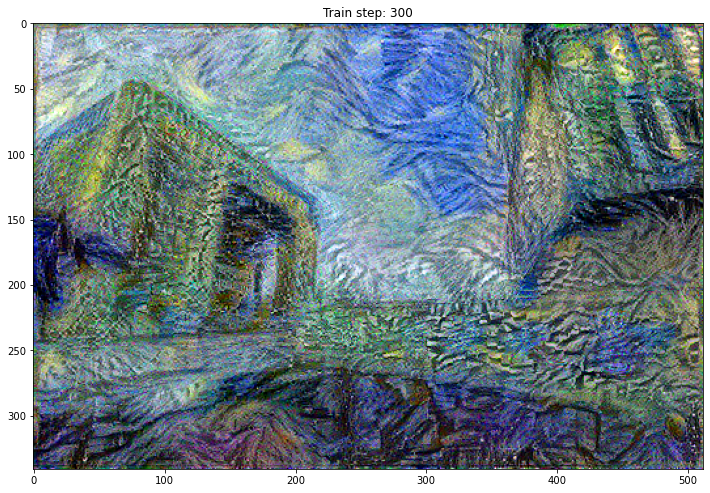

  0%|          | 0/100 [00:00<?, ?it/s]

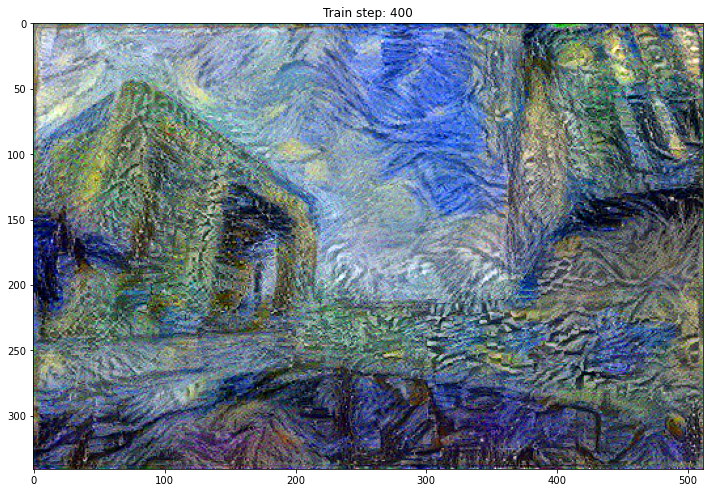

  0%|          | 0/100 [00:00<?, ?it/s]

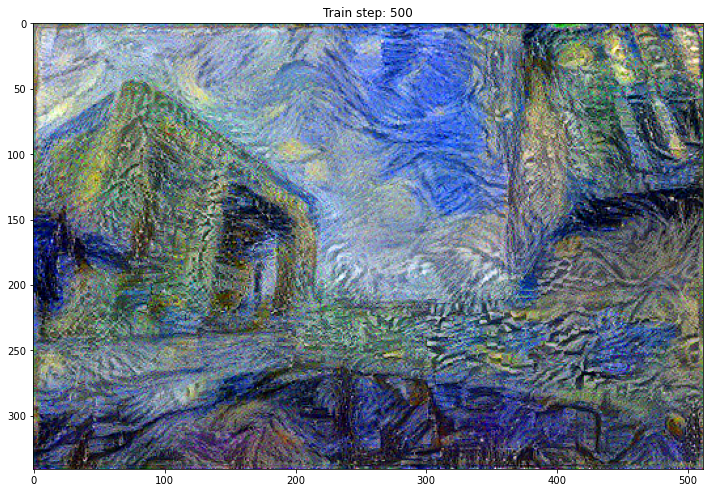

  0%|          | 0/100 [00:00<?, ?it/s]

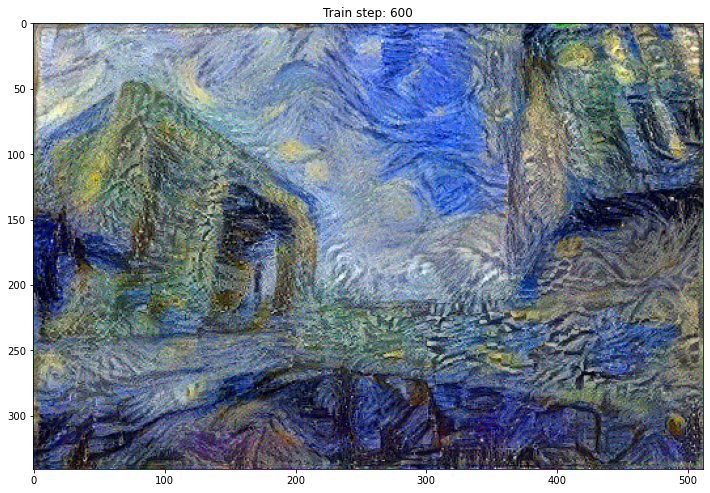

  0%|          | 0/100 [00:00<?, ?it/s]

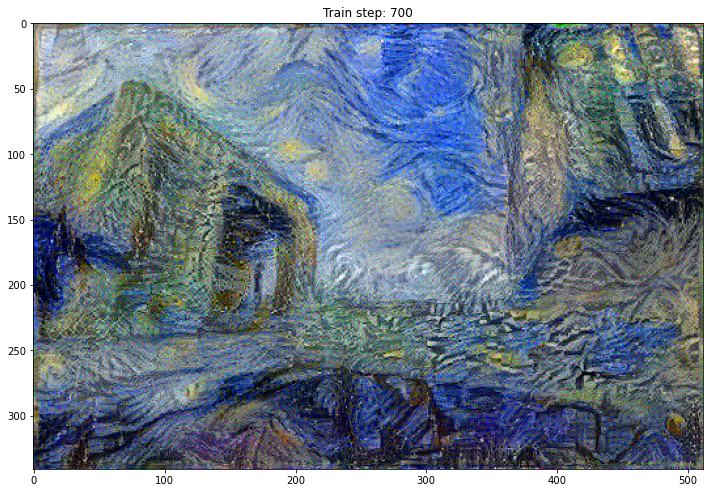

  0%|          | 0/100 [00:00<?, ?it/s]

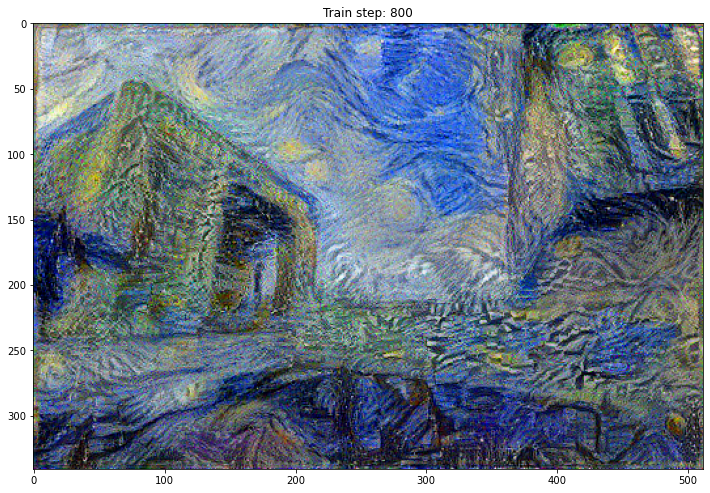

  0%|          | 0/100 [00:00<?, ?it/s]

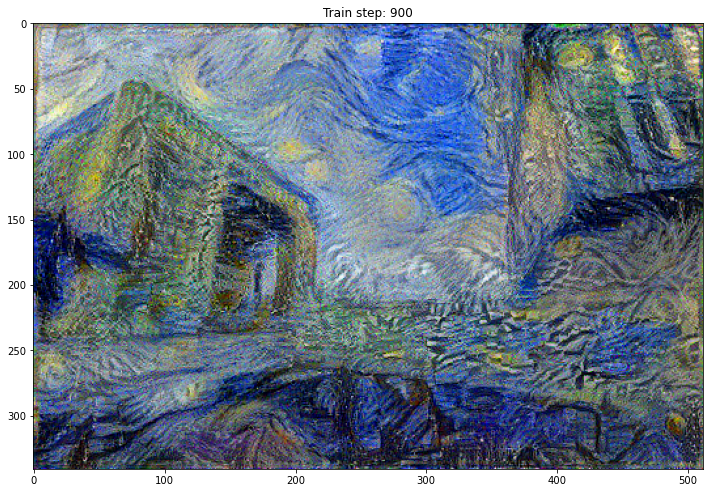

  0%|          | 0/100 [00:00<?, ?it/s]

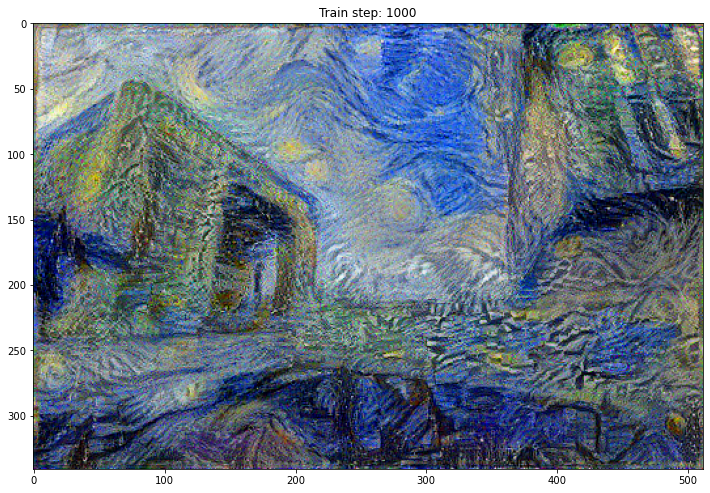

Total time: 74.2


In [27]:
image = train_style_transfer(image, 
                             opt=opt,
                             epochs=10, 
                             steps_per_epoch=100,
                             style_weight=1, 
                             content_weight=1, 
                             total_variation_weight=1)

In [28]:
file_name = './output_HW/style_transfer_nthu_starry_night_style_diff_layer.png'
mpl.image.imsave(file_name, image[0].numpy())

# Part II (AdaIN)

## 一. 資料前處理
這一大點完全按照課程網頁給的code處理就OK了。
### 1. Parameter defination

In [29]:
%matplotlib inline

CONTENT_DIRS = ['./input/mscoco/test2014']
STYLE_DIRS = ['./input/wikiart/test']

# VGG19 was trained by Caffe which converted images from RGB to BGR,
# then zero-centered each color channel with respect to the ImageNet 
# dataset, without scaling.  
IMG_MEANS = np.array([103.939, 116.779, 123.68]) # BGR

IMG_SHAPE = (224, 224, 3) # training image shape, (h, w, c)
SHUFFLE_BUFFER = 1000
BATCH_SIZE = 32
EPOCHS = 30
STEPS_PER_EPOCH = 12000 // BATCH_SIZE

### 2. Sample and plot function

Sampled content images:


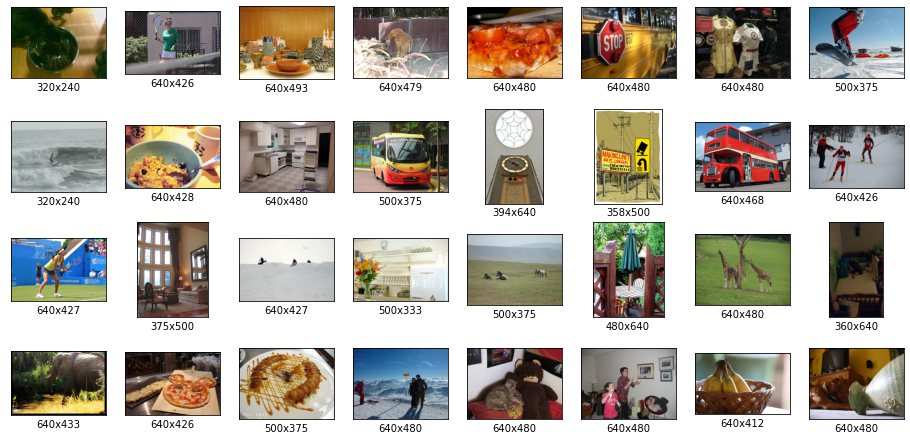

Sampled style images:


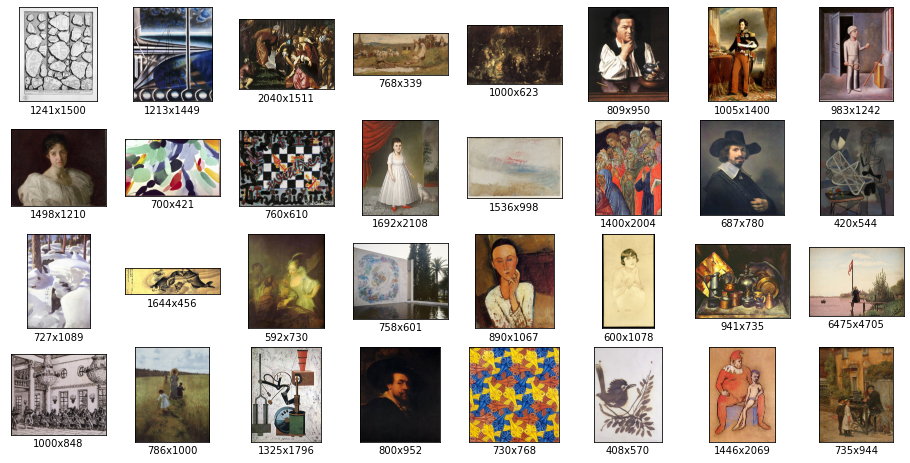

In [30]:
def sample_files(dir, num, pattern='**/*.jpg'):
    '''Samples files in a directory using the reservoir sampling.'''

    paths = Path(dir).glob(pattern) # list of Path objects
    sampled = []
    for i, path in enumerate(paths):
        if i < num:
            sampled.append(path) 
        else:
            s = random.randint(0, i)
            if s < num:
                sampled[s] = path
    return sampled

def plot_images(dir, row, col, pattern):
    paths = sample_files(dir, row*col, pattern)

    plt.figure(figsize=(2*col, 2*row))
    for i in range(row*col):
        im = Image.open(paths[i])
        w, h = im.size

        plt.subplot(row, col, i+1)
        plt.imshow(im)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        plt.xlabel(f'{w}x{h}')
    plt.show()

print('Sampled content images:')
plot_images(CONTENT_DIRS[0], 4, 8, pattern='*.jpg')

print('Sampled style images:')
plot_images(STYLE_DIRS[0], 4, 8, pattern='*.jpg')

### 3. Remove small images or grayscale images.
Before creating dataset API, first we have to remove some unwanted data, such as small images or grayscale images.

In [31]:
def clean(dir_path, min_shape=None):
    paths = Path(dir_path).glob('**/*.jpg')
    deleted  = 0
    for path in paths:
        try:
            # Make sure we can decode the image
            im = tf.io.read_file(str(path.resolve()))
            im = tf.image.decode_jpeg(im)

            # Remove grayscale images 
            shape = im.shape
            if shape[2] < 3:
                path.unlink()
                deleted += 1

            # Remove small images
            if min_shape is not None:
                if shape[0] < min_shape[0] or shape[1] < min_shape[1]:
                    path.unlink()
                    deleted += 1
        except Exception as e:
            path.unlink()
            deleted += 1
    return deleted

for dir in CONTENT_DIRS:
    deleted = clean(dir)
print(f'#Deleted content images: {deleted}')

for dir in STYLE_DIRS:
    deleted = clean(dir)
print(f'#Deleted style images: {deleted}')

#Deleted content images: 0


Corrupt JPEG data: 3909 extraneous bytes before marker 0xd9
Corrupt JPEG data: 10 extraneous bytes before marker 0xd9
2021-11-18 19:46:15.158517: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile
Corrupt JPEG data: 6 extraneous bytes before marker 0xda
Corrupt JPEG data: premature end of data segment
Corrupt JPEG data: premature end of data segment


#Deleted style images: 0


### 4. Build dataset
VGG19 was trained by Caffe which converted images from RGB to BGR, then zero-centered each color channel with respect to the ImageNet dataset, without scaling. Therefore, we have to do the same thing during data preprocessing.

In [32]:
def preprocess_image(path, init_shape=(448, 448)):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, init_shape)
    image = tf.image.random_crop(image, size=IMG_SHAPE)
    image = tf.cast(image, tf.float32)
    
    # Convert image from RGB to BGR, then zero-center each color channel with
    # respect to the ImageNet dataset, without scaling.
    image = image[..., ::-1] # RGB to BGR
    image -= (103.939, 116.779, 123.68) # BGR means
    return image

def np_image(image):
    image += (103.939, 116.779, 123.68) # BGR means
    image = image[..., ::-1] # BGR to RGB
    image = tf.clip_by_value(image, 0, 255)
    image = tf.cast(image, dtype='uint8')
    return image.numpy()

def build_dataset(num_gpus=1):
    c_paths = []
    for c_dir in CONTENT_DIRS:
        c_paths += Path(c_dir).glob('*.jpg')
    c_paths = [str(path.resolve()) for path in c_paths]
    s_paths = []
    for s_dir in STYLE_DIRS:
        s_paths += Path(s_dir).glob('*.jpg')
    s_paths = [str(path.resolve()) for path in s_paths]
    print(f'Building dataset from {len(c_paths):,} content images and {len(s_paths):,} style images... ', end='')

    AUTOTUNE = tf.data.experimental.AUTOTUNE

    c_ds = tf.data.Dataset.from_tensor_slices(c_paths)
    c_ds = c_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    c_ds = c_ds.repeat()
    c_ds = c_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    s_ds = tf.data.Dataset.from_tensor_slices(s_paths)
    s_ds = s_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    s_ds = s_ds.repeat()
    s_ds = s_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    ds = tf.data.Dataset.zip((c_ds, s_ds))
    ds = ds.batch(BATCH_SIZE * num_gpus)
    ds = ds.prefetch(buffer_size=AUTOTUNE)

    print('done')
    return ds

Building dataset from 40,736 content images and 23,585 style images... done


/home/benny/anaconda3/envs/tf/lib/python3.8/site-packages/tensorflow/python/data/ops/dataset_ops.py:3703: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  warnings.warn(
2021-11-18 19:48:34.871053: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:176] None of the MLIR Optimization Passes are enabled (registered 2)
2021-11-18 19:48:34.888361: I tensorflow/core/platform/profile_utils/cpu_utils.cc:114] CPU Frequency: 2592000000 Hz


Content batch shape: (32, 224, 224, 3)
Style batch shape: (32, 224, 224, 3)


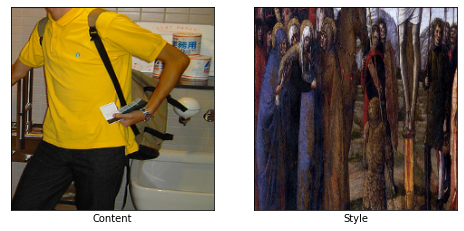

In [33]:
ds = build_dataset()
c_batch, s_batch = next(iter(ds.take(1)))

print('Content batch shape:', c_batch.shape)
print('Style batch shape:', s_batch.shape)

plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.imshow(np_image(c_batch[0]))
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.xlabel('Content')

plt.subplot(1, 2, 2)
plt.imshow(np_image(s_batch[0]))
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.xlabel('Style')

plt.show()

## 二. Adaptive Instance Normalization
令content input為$x$，style input為y。我們定義$x$, $y$之Adaptive Instance Normalization為
$$\text{AdaIN}(x,y)=\sigma(y)\bigg(\frac{x−\mu(x)}{\sigma(x)}\bigg)+\mu(y)$$
看起來我們要繼承tf.keras.layers.Layer來實做AdaIN layer。先查看tf.keras.layers.Layer的文件[3]，我至少必須實做__init__與call函式。接著，從class ArbitraryStyleTransferNet中，有幾行程式碼提到了我們要實做的AdaIN。這給了我們一些IO的提示。

1. self.adain = AdaIN(name='adain')

所以我們的init function要繼承tf.keras.layers.Layer，接著必須要含有name這個屬性（一個字串）

2. normalized_c = self.adain((c_enc_c, s_enc_c))

這一行code提示了我們的AdaIN的input, output。從變數名稱判斷，他要我們丟進(content image, style image)這個tuple。並回傳可以丟進decoder的tensor normalized_c。

3. for迴圈中的幾行code

    o_mean, o_var = tf.nn.moments(o, axes=(1,2), keepdims=True)
    
    o_std = tf.sqrt(o_var + self.adain.epsilon)
    
    s_mean, s_var = tf.nn.moments(s, axes=(1,2), keepdims=True)
    
    s_std = tf.sqrt(s_var + self.adain.epsilon)
    
這提示我們AdaIN要有一個屬性稱之為epsilon，我認為是為了避免數值上的錯誤而故意加一個很小的浮點數。另外tf.nn.moments這個函式也很方便，可以直接計算mean和variance。

這樣一來如何實做AdaIN就很明顯了：

__init__直接繼承layers[1][3]，並初始化name以及epsilon屬性。

call直接吃進(content image, style image)這個tuple，拆開後利用tf.nn.moments[2]，將每個channel沿著height和width的方向運算mean和variance，以計算上面的公式。

keeps dimension要是true[4]。

我還遇到一個問題：為什麼mscoco dataset可以跑，但是nthu的照片跑出來的結果卻是一整片灰色？後來參考[5]，發現在call function的tf.sqrt後加上一個很小的數字就可以解決這個問題。因此我猜是遇到了分母=0的問題。

In [34]:
class AdaIN(tf.keras.layers.Layer):
    def __init__(self, name='AdaIN', epsilon=1e-7):
        super(AdaIN, self).__init__(name=name) # tf.keras.layers.Layer已有name這個屬性
        self.epsilon = epsilon

    def call(self, content_style_tuple):
        # 1. (content_image, style_image) = content_style_tuple
        x = content_style_tuple[0]
        y = content_style_tuple[1]
        
        # 2. Compute the means and 標準差
        mu_x, var_x = tf.nn.moments(x, axes=[1,2], keepdims=True) # 沿著height和width的方向
        mu_y, var_y = tf.nn.moments(y, axes=[1,2], keepdims=True) # 沿著height和width的方向
        sigma_x = tf.sqrt(var_x)+self.epsilon # must add a very small number
        sigma_y = tf.sqrt(var_y)+self.epsilon
        
        # 3. 計算AdaIN的公式
        output = sigma_y*((x-mu_x)/sigma_x) + mu_y
        
        return output

剩下的code就可以完全按照課程網頁的code跑了。

In [35]:
class ArbitraryStyleTransferNet(tf.keras.Model):
    CONTENT_LAYER = 'block4_conv1'
    STYLE_LAYERS = ('block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1')

    @staticmethod
    def declare_decoder():
        a_input = tf.keras.Input(shape=(28, 28, 512), name='input_adain')

        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(a_input)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(128, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(128, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(64, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(64, 3, padding='same', activation='relu')(h)
        output = tf.keras.layers.Conv2DTranspose(3, 3, padding='same')(h)

        return tf.keras.Model(inputs=a_input, outputs=output, name='decoder')
  
    def __init__(self,
                 img_shape=(224, 224, 3),
                 content_loss_weight=1,
                 style_loss_weight=10,
                 name='arbitrary_style_transfer_net',
                 **kwargs):
        super(ArbitraryStyleTransferNet, self).__init__(name=name, **kwargs)

        self.img_shape = img_shape
        self.content_loss_weight = content_loss_weight
        self.style_loss_weight = style_loss_weight
        
        vgg19 = tf.keras.applications.VGG19(include_top=False, weights='imagenet', input_shape=img_shape)
        vgg19.trainable = False

        c_output = [vgg19.get_layer(ArbitraryStyleTransferNet.CONTENT_LAYER).output]
        s_outputs = [vgg19.get_layer(name).output for name in ArbitraryStyleTransferNet.STYLE_LAYERS]
        self.vgg19 = tf.keras.Model(inputs=vgg19.input, outputs=c_output+s_outputs, name='vgg19')
        self.vgg19.trainable = False

        self.adain = AdaIN(name='adain')
        self.decoder = ArbitraryStyleTransferNet.declare_decoder()
  
    def call(self, inputs):
        c_batch, s_batch = inputs

        c_enc = self.vgg19(c_batch)
        c_enc_c = c_enc[0]

        s_enc = self.vgg19(s_batch)
        s_enc_c = s_enc[0]
        s_enc_s = s_enc[1:] 
        
        # normalized_c is the output of AdaIN layer
        normalized_c = self.adain((c_enc_c, s_enc_c))
        output = self.decoder(normalized_c)

        # Calculate loss
        out_enc = self.vgg19(output)
        out_enc_c = out_enc[0]
        out_enc_s = out_enc[1:]

        loss_c = tf.reduce_mean(tf.math.squared_difference(out_enc_c, normalized_c))
        self.add_loss(self.content_loss_weight * loss_c)
        
        loss_s = 0
        for o, s in zip(out_enc_s, s_enc_s):    
            o_mean, o_var = tf.nn.moments(o, axes=(1,2), keepdims=True)
            o_std = tf.sqrt(o_var + self.adain.epsilon)

            s_mean, s_var = tf.nn.moments(s, axes=(1,2), keepdims=True)
            s_std = tf.sqrt(s_var + self.adain.epsilon)

            loss_mean = tf.reduce_mean(tf.math.squared_difference(o_mean, s_mean))
            loss_std = tf.reduce_mean(tf.math.squared_difference(o_std, s_std))

            loss_s += loss_mean + loss_std
        self.add_loss(self.style_loss_weight * loss_s)

        return output, c_enc_c, normalized_c, out_enc_c

In [36]:
# Plot results
def plot_outputs(outputs, captions=None, col=5):
    row = len(outputs)
    plt.figure(figsize=(3*col, 3*row))
    for i in range(col):
        for j in range(row):
            plt.subplot(row, col, j*col+i+1)
            plt.imshow(np_image(outputs[j][i,...,:3]))
            plt.grid(False)
            plt.xticks([])
            plt.yticks([])
            if captions is not None:
                plt.xlabel(captions[j])
    plt.show()

檢查一下我們的模型長什麼樣子。看起來應該是有符合課程網頁說的模樣。

In [37]:
ds = build_dataset()
model = ArbitraryStyleTransferNet(img_shape=IMG_SHAPE)

c_batch, s_batch = next(iter(ds.take(1)))
print(f'Input shape: ({c_batch.shape}, {s_batch.shape})')
output, *_ = model((c_batch, s_batch))
print(f'Output shape: {output.shape}')
print(f'Init. content loss: {model.losses[0]:,.2f}, style loss: {model.losses[1]:,.2f}')
model.summary()

Building dataset from 40,736 content images and 23,585 style images... done
Input shape: ((32, 224, 224, 3), (32, 224, 224, 3))
Output shape: (32, 224, 224, 3)
Init. content loss: 1,757,911.38, style loss: 10,562,424.00
Model: "arbitrary_style_transfer_net"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Functional)           [(None, 28, 28, 512), (No 3505728   
_________________________________________________________________
adain (AdaIN)                multiple                  0         
_________________________________________________________________
decoder (Functional)         (None, 224, 224, 3)       3505219   
Total params: 7,010,947
Trainable params: 3,505,219
Non-trainable params: 3,505,728
_________________________________________________________________


## 三. Train the model
這一大點也是完全按照課程網站上的code寫就能順利運作。

In [38]:
# Train the model
optimizer = tf.keras.optimizers.Adam(lr=5e-4)
c_loss_metric, s_loss_metric = tf.keras.metrics.Mean(), tf.keras.metrics.Mean()

CKP_DIR = 'checkpoints'
init_epoch = 1

ckp = tf.train.latest_checkpoint(CKP_DIR)
if ckp:
    model.load_weights(ckp)
    init_epoch = int(ckp.split('_')[-1]) + 1
    print(f'Resume training from epoch {init_epoch-1}')

Resume training from epoch 30


/home/benny/anaconda3/envs/tf/lib/python3.8/site-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:374: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [39]:
@tf.function
def train_step(inputs):
    with tf.GradientTape() as tape:
        model(inputs)
        c_loss, s_loss = model.losses
        loss = c_loss + s_loss
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

    c_loss_metric(c_loss)
    s_loss_metric(s_loss)

In [40]:
def train(dataset, init_epoch):
    for epoch in tqdm(range(init_epoch, EPOCHS+1)):
        print(f'Epoch {epoch:>2}/{EPOCHS}')
        for step, inputs in enumerate(ds.take(STEPS_PER_EPOCH)):
            train_step(inputs)
            print(f'{step+1:>5}/{STEPS_PER_EPOCH} - loss: {c_loss_metric.result()+s_loss_metric.result():,.2f} - content loss: {c_loss_metric.result():,.2f} - style loss: {s_loss_metric.result():,.2f}', end='\r') 

        print()
        model.save_weights(os.path.join(CKP_DIR, f'ckpt_{epoch}'))
        c_loss_metric.reset_states()
        s_loss_metric.reset_states()

        output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
        plot_outputs((s_batch, c_batch, output, c_enc_c, normalized_c, out_enc_c), 
                     ('Style', 'Content', 'Trans', 'Content Enc', 'Normalized', 'Trans Enc'))

In [41]:
train(ds, init_epoch)

0it [00:00, ?it/s]

## 四. Testing
### 1. 隨機從dataset取數張照片進行AdaIN style transfer

Building dataset from 40,736 content images and 23,585 style images... done
Recovered loss: 559592.25


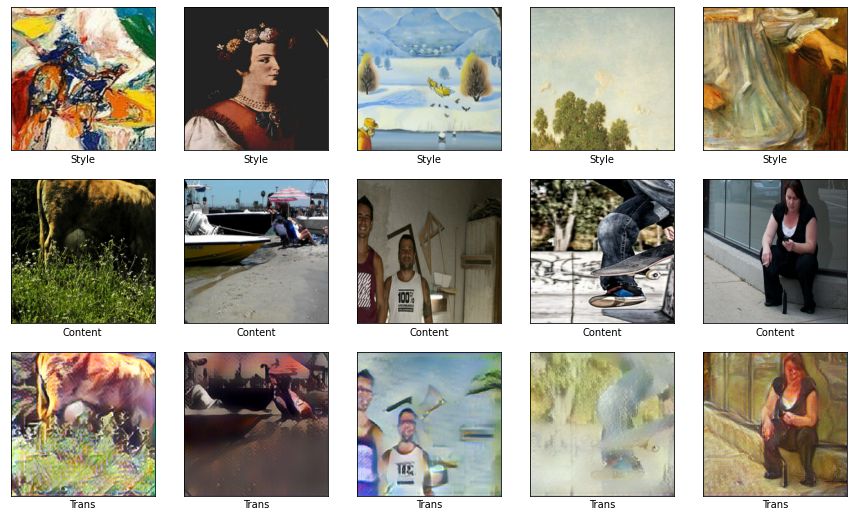

Recovered loss: 533486.25


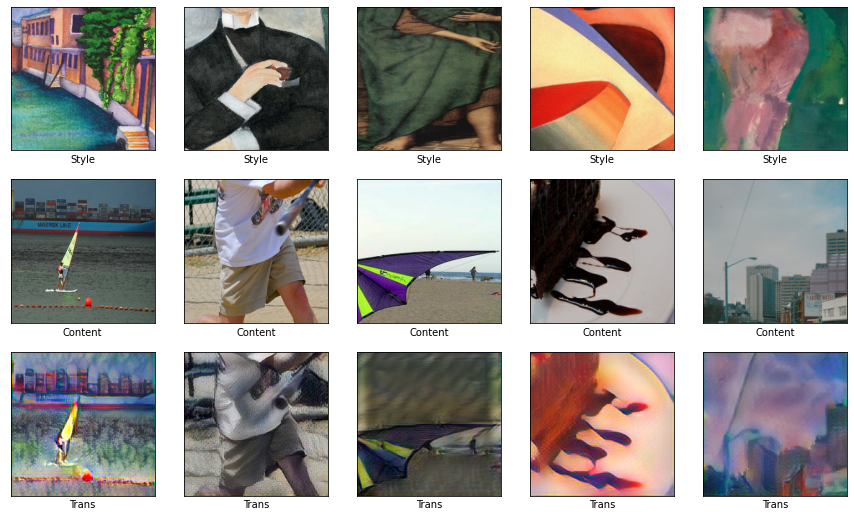

In [42]:
CKP_DIR = 'checkpoints/ckpt_20'

model = ArbitraryStyleTransferNet(img_shape=IMG_SHAPE)
model.load_weights(CKP_DIR)

ds = build_dataset()

for idx, (c_batch, s_batch) in enumerate(ds):
    if idx > 1:
        break
    output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
    print('Recovered loss:', tf.reduce_sum(model.losses).numpy())

    plot_outputs((s_batch, c_batch, output), ('Style', 'Content', 'Trans'))

### 2. 將NTHU Example以AdaIN進行style transfer。

In [43]:
def preprocess_example(path, init_shape=(IMG_SHAPE[0], IMG_SHAPE[1])):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, init_shape)
    image = tf.cast(image, tf.float32)
    
    # Convert image from RGB to BGR, then zero-center each color channel with
    # respect to the ImageNet dataset, without scaling.
    image = image[..., ::-1] # RGB to BGR
    image -= (103.939, 116.779, 123.68) # BGR means
    return image

def nthu_example(num_gpus=1):
    c_paths = ['./input/content_nthu.jpg']
    
    s_paths = []
    for s_dir in STYLE_DIRS:
        s_paths += Path(s_dir).glob('*.jpg')
    s_paths = [str(path.resolve()) for path in s_paths]
    print(f'Building dataset from {len(c_paths):,} content images and {len(s_paths):,} style images... ', end='')
    
    AUTOTUNE = tf.data.experimental.AUTOTUNE
    
    c_ds = tf.data.Dataset.from_tensor_slices(c_paths)
    c_ds = c_ds.map(preprocess_example, num_parallel_calls=AUTOTUNE)
    c_ds = c_ds.repeat()
    c_ds = c_ds.shuffle(buffer_size=SHUFFLE_BUFFER)
    
    s_ds = tf.data.Dataset.from_tensor_slices(s_paths)
    s_ds = s_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    s_ds = s_ds.repeat()
    s_ds = s_ds.shuffle(buffer_size=SHUFFLE_BUFFER)
    
    ds = tf.data.Dataset.zip((c_ds, s_ds))
    ds = ds.batch(BATCH_SIZE * num_gpus)
    ds = ds.prefetch(buffer_size=AUTOTUNE)
    
    print('done')
    return ds

Building dataset from 1 content images and 23,585 style images... done


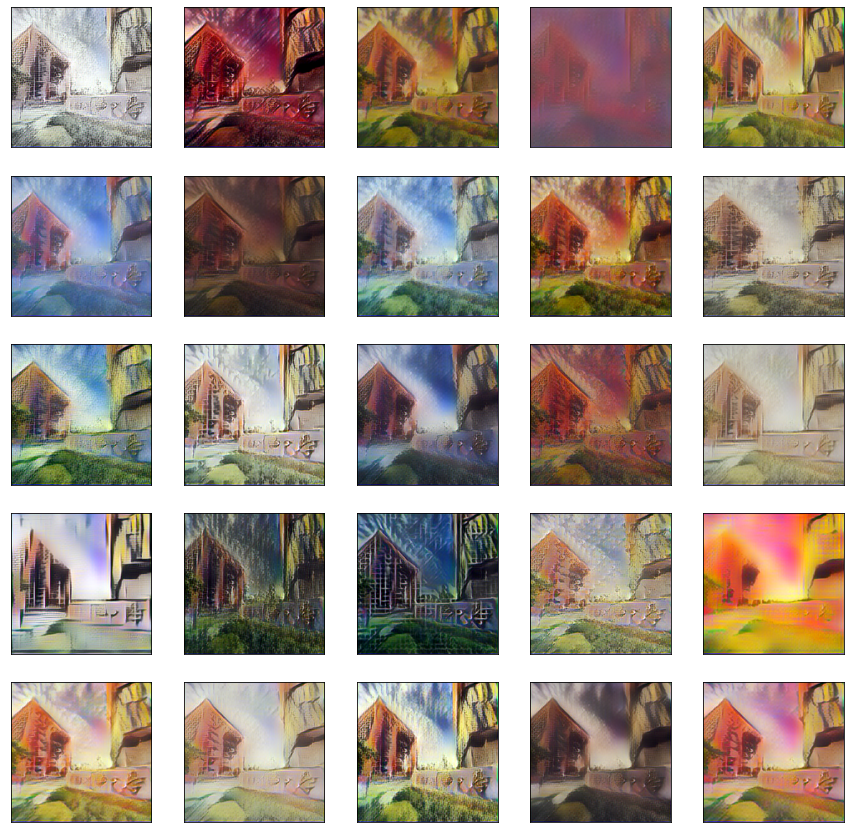

In [44]:
ds = nthu_example()
outputs = []

for idx, (c_batch, s_batch) in enumerate(ds):
    if idx > 4:
        break
    output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
    outputs.append(output)
    
plot_outputs((outputs))

## 參考資料：

[1] https://www.runoob.com/python/python-func-super.html

[2] https://www.tensorflow.org/api_docs/python/tf/nn/moments

[3] https://www.tensorflow.org/api_docs/python/tf/keras/layers/Layer

[4] https://github.com/liuwei16/adain-keras/blob/master/layers.py?fbclid=IwAR2rDN4uYOFymJHaSsRgxC3Q5AkwJwTEJ_DCg8kHqVyoVpO3d77hKCAO-bA

[5] https://github.com/gs18113/AdaIN-TensorFlow2/blob/master/functions.py